In [1]:
# Copyright 2020 Fabian Hofmann
#
# Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
#     http://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

# Conditional Generative Adversarial Network for Video

This is an extension of our [modified implementation](https://gitlab.tubit.tu-berlin.de/sulandir/Thesis/blob/master/src/models/vgan.ipynb) of the VGAN structure proposed by Vondrick et al. [\[1\]](http://www.cs.columbia.edu/~vondrick/tinyvideo/). In this case, generated video frames have to be extrapolated from an existing frame (`x_0`), that is given to the generator. Vondrick et al. do this by attaching an encoder to the generator network, that encodes the 2d image that functions as input to the generator instead of gaussian noise. This combined with an extension of the error -- the generated video's first frame `G_0` has to match `x_0`, supposedly creates videos that reconstruct the input image and generate the following videos starting from that one. This approach of Vondrick et al. was inspired by other works that make use of conditional generative adversarial networks (C-GAN). Further details of the the implementation and the approach can be found below.

As with our implementation of VGAN, C-VGAN is heavily modified to fit our [data](https://gitlab.tubit.tu-berlin.de/sulandir/thesis_data). The author's code was once again not only written in LUA/Torch but in direct contradiction to their website, that is dedicated to the VGAN paper (different number of channels, output dimensions, number of layers, etc.). Therefore, we adapted our already modified version of the paper even more, but keeping the overall idea of C-VGAN. Because the code below is similar to our implementation of VGAN, we outsourced the most complex functions to python modules and included less explanations of functionalities linked to general VGAN; the scope of this notebook is the conditional part of C-VGAN. Read the [VGAN notebook](https://gitlab.tubit.tu-berlin.de/sulandir/Thesis/blob/master/src/models/vgan.ipynb) for those comments and functions missing here.

## Setup

In [2]:
import tensorflow as tf

tf.__version__

'2.1.0'

In [3]:
if tf.test.gpu_device_name():
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))
else:
    print("Please install GPU version of TF")

Default GPU Device: /device:GPU:0


In [4]:
import cv2
import numpy as np
import os
import time

from IPython import display
from matplotlib import pyplot as plt

# git+https://github.com/tensorflow/docs
import tensorflow_docs.vis.embed as embed

from src.io_.batch_generator import UniformBatchGenerator, BatchLoader
from src.io_.gif_writer import write_gif, write_gif_grid
from src.models.vgan import *

In [5]:
base_input_path = "../../data/upCam/preprocessed_128_64/"
base_output_path = "../../output/models/vgan/vgan_conditional/"

## Instantiate the batch generator and examples

The discriminator is trained on ~1.5 second (8 frames) long video clips (`train_y`), sampled from the created video dataset, while the conditional generator has to generate videos resembling real ones, while also fitting the first frame of its generated video to its input frame (`train_x`).

The BatchGenerator will be later (at the training step) wrapped in a `BatchLoader` to allow concurrent loading of data from the generator while the model trains, so there is nothing to be done except instantiating the generator.

In [6]:
BATCH_SIZE = 64

days = ["00", "01", "02", "03", "04"]
day_paths = [base_input_path + day + "/" for day in days]

uniform_sampler = UniformBatchGenerator(day_paths=day_paths, batch_size=BATCH_SIZE, sample_size=8, subsample_size=1)

Check the shapes of the batches generated. For `train_x` that are singular frames, the shape is wrong (there is one redundant dimension, time). This dimension will be removed by reshaping the input via the generator network (`layers.Reshape()`).

In [7]:
train_x, train_y = uniform_sampler[0]

assert np.shape(train_x) == (64, 1, 64, 128, 3) # (samples, frames, height, width, channels)
assert np.shape(train_y) == (64, 8, 64, 128, 3) # (samples, frames, height, width, channels)

Display one of the video clips (as GIF)...


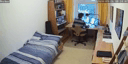

In [8]:
anim_file = base_output_path + "anim/test_clip.gif"

write_gif(anim_file, train_y[60], fps=5)
embed.embed_file(anim_file)

... and its corresponding first frame:

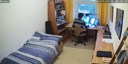

In [9]:
anim_file_frame = base_output_path + "anim/test_frame.png"

cv2.imwrite(anim_file_frame, (train_x[60][0] * 127.5 + 127.5).astype("uint8"))
display.Image(anim_file_frame)

To check up on the generator's training progress later, we will need some example input frames. For this we are using a subset of the first batch; 8 frames from day and night videos each.


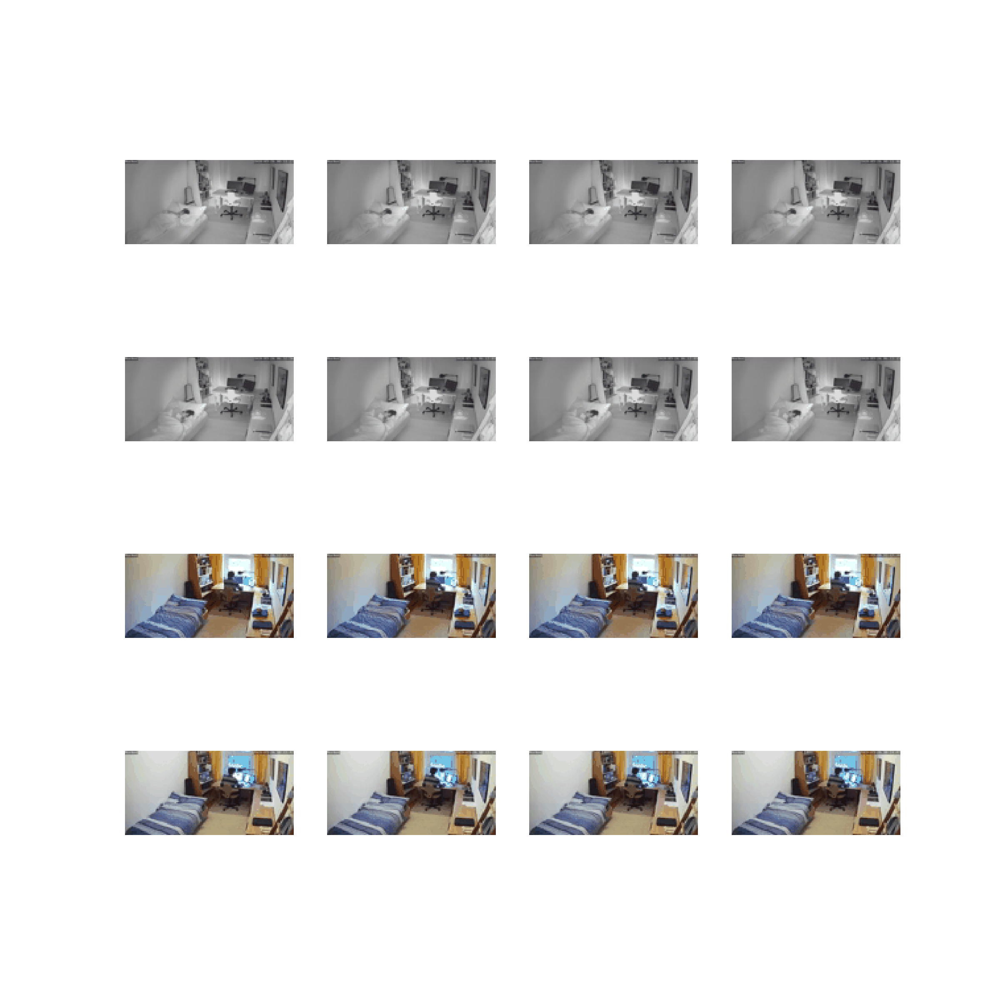

In [10]:
examples_input = train_x[::4]
image_file_grid = base_output_path + "anim/example_frame_grid.gif"

write_gif_grid(image_file_grid, examples_input, fps=5, dpi=600)
embed.embed_file(image_file_grid)

## Create the models

Models are created using the [Keras Function API](https://www.tensorflow.org/guide/keras/functional).

### The Generator

The conditional generator is the same model as the general VGAN generator, but with a twist; instead of latent code, an encoder transforms one input frame to latent space. The encoder is CNN. There are (as mentioned at the start of this notebook) some issues however: When one compares the figure (from the author's [website](http://www.cs.columbia.edu/~vondrick/tinyvideo/)) to the actual code of their conditional VGAN, one notices a multitude of issues:
- None of the parameters were listed in the paper, except that a five layer conditional frame work was attached to the generator network - not even the figure below was listed (but a section dedicated to this approach including results were listed).
- The actual code of the encoder has merely 4 convolutional layers, with the final one having `1024` instead of `512` channels in its output, while the first one has `128` output channels instead of `64`.
- The generator was -- unlike the paper and figure said, modified:
    - The background stream directly upsamples from the encoder output, `4x4` with `1024` channels, to a higher dimension (`8x8` with `512` channels), no longer matching the pace of the original upsampling.
    - The generator does something similar after upsampling the 2D output of the encoder to 3D by using a fractional strided convolutional layer (stride of `2x1x1`, kernel size `1`)
- All convolutional layers use batch normalization and ReLU activation. The first layer does not use batch norm.

![c-generator](http://www.cs.columbia.edu/~vondrick/tinyvideo/future.png)

Because we do not know why these changes were made -- we can assume that the bottleneck of the encoder was too strong (the author hinted at that on their website regarding weaknesses of C-VGAN), we decided to stick to our VGAN implementation and extend that with the original intend of C-VGAN, i.e. merely adding an 2D convolutional encoder to the generator. Any further changes will be done in our actual extension of the C-VGAN approach for frame forecasting (that uses a video instead of a single input frame as a condition). Therefore, we made following design decisions for the encoder and its connections to the rest of the generator:
- The encoder is the (modified) inverse of our background stream in structure, sampling the `64x128` input frame to a resolution of `2x4`.
- Strides convolutions with kernel size of `3` and stride of `2` are applied on each convolutional layer.
- There are 5 layers -- the number of filters however range from `64` to `1024` instead of `32` to `512`.
- The encoder output (`2x4` with `1024` channels) is directly fed into the background stream, while for the foreground stream, the time dimension is upsampled to `2` by a fractional strided convolutional network with `512` filters and stride `2x1x1`.
- Weights are initialized with `tf.keras.initializers.HeNormal`.

#### The Encoder

In [11]:
def make_encoder_stream(inputs: tf.Tensor) -> tf.Tensor:
    x: tf.Tensor = layers.Conv2D(filters=64, kernel_size=3, strides=2,
                                 padding="same", use_bias=False, kernel_initializer="he_normal")(inputs)
    assert x.shape.as_list() == [None, 32, 64, 64]
    x = layers.ReLU()(x)

    x = layers.Conv2D(filters=128, kernel_size=3, strides=2,
                      padding="same", use_bias=False, kernel_initializer="he_normal")(x)
    assert x.shape.as_list() == [None, 16, 32, 128]
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

    x = layers.Conv2D(filters=256, kernel_size=3, strides=2,
                      padding="same", use_bias=False, kernel_initializer="he_normal")(x)
    assert x.shape.as_list() == [None, 8, 16, 256]
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

    x = layers.Conv2D(filters=512, kernel_size=3, strides=2,
                      padding="same", use_bias=False, kernel_initializer="he_normal")(x)
    assert x.shape.as_list() == [None, 4, 8, 512]
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

    x = layers.Conv2D(filters=1024, kernel_size=3, strides=2,
                      padding="same", use_bias=False, kernel_initializer="he_normal")(x)
    assert x.shape.as_list() == [None, 2, 4, 1024]
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

    return x

#### Putting the two parts together

Nothing for foreground or background stream, or the combiner for the two has to be changed (see the entry text to this section), so these parts of the generator model were outsourced into a separate [module](https://gitlab.tubit.tu-berlin.de/sulandir/Thesis/blob/master/src/models/vgan.py) to be included.

As listed earlier, the output of the encoder (`2x4` with `1024` channels) can be directly fed into the background stream. For the foreground stream, an additional fractional strided convolutional network with `512` filters and stride `2x1x1` to fit the input dimension of the stream.

In [12]:
def make_generator_model() -> keras.Model:
    inputs: tf.Tensor = keras.Input(shape=(1, 64, 128, 3))

    # Reshape into 2D
    x: tf.Tensor = layers.Reshape((64, 128, 3))(inputs)
    assert x.get_shape().as_list() == [None, 64, 128, 3]

    e: tf.Tensor = make_encoder_stream(x)

    # Adapt encoded input to background stream format and create stream
    e_3d: tf.Tensor = layers.Reshape((1, 2, 4, 1024))(e)
    e_3d =  layers.Conv3DTranspose(filters=512, kernel_size=3, strides=(2, 1, 1),
                                   padding="same", use_bias=False, kernel_initializer="he_normal")(e_3d)
    assert e_3d.shape.as_list() == [None, 2, 2, 4, 512]
    e_3d = layers.BatchNormalization()(e_3d)
    e_3d = layers.ReLU()(e_3d)
    f, m = make_generator_foreground_stream(e_3d)

    b = make_generator_background_stream(e)

    outputs = make_generator_stream_combiner(f, m, b)

    return keras.Model(inputs=inputs, outputs=outputs, name="c_vgan_generator")

Create the generator model, and check the model summary:

In [13]:
c_vgan_generator = make_generator_model()
c_vgan_generator.summary()

Model: "c_vgan_generator"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 1, 64, 128,  0                                            
__________________________________________________________________________________________________
reshape (Reshape)               (None, 64, 128, 3)   0           input_1[0][0]                    
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 32, 64, 64)   1728        reshape[0][0]                    
__________________________________________________________________________________________________
re_lu (ReLU)                    (None, 32, 64, 64)   0           conv2d[0][0]                     
___________________________________________________________________________________

Display the input and output shapes of each layer as a DAG in a plotted graph:

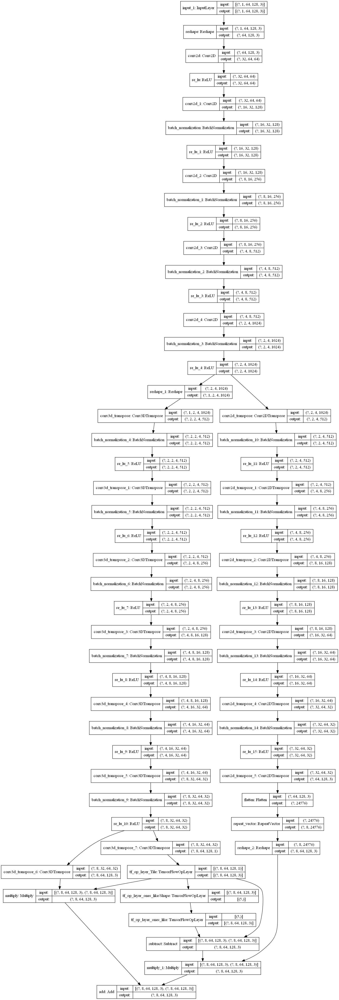

In [14]:
keras.utils.plot_model(c_vgan_generator, base_output_path + "img/c_vgan_generator.png", show_shapes=True)

Use the untrained generator to create a number of test videos from our example inputs:


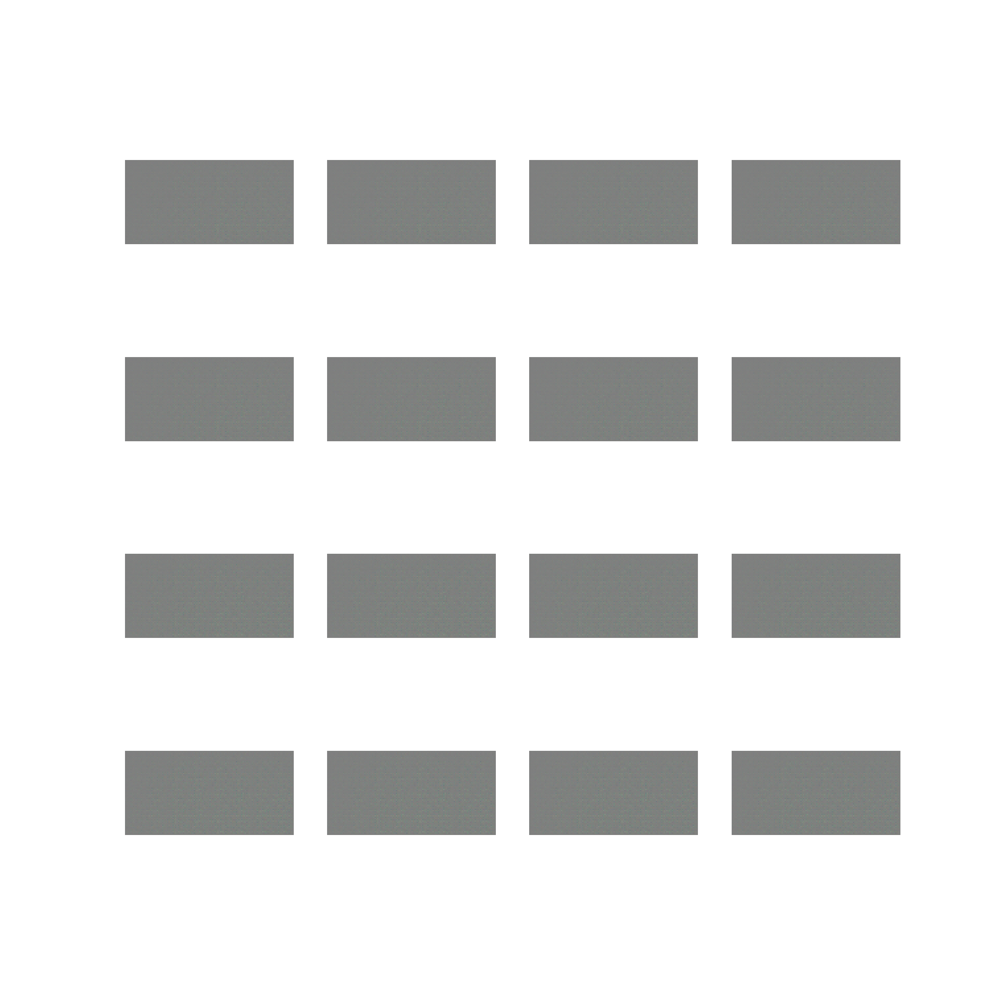

In [15]:
generated_test_videos = c_vgan_generator(examples_input, training=False).numpy()

anim_file_grid = base_output_path + "anim/test_example_grid.gif"
write_gif_grid(anim_file_grid, generated_test_videos, fps=5, dpi=600)
embed.embed_file(anim_file_grid)

### The Discriminator

The discriminator has not changed at all, so we outsourced it to a separate [module](https://gitlab.tubit.tu-berlin.de/sulandir/Thesis/blob/master/src/models/vgan.py). For an extended documentation check the [VGAN notebook](https://gitlab.tubit.tu-berlin.de/sulandir/Thesis/blob/master/src/models/vgan.ipynb).

Create the discriminator, and test it with the first generated video from generated example batch.

In [16]:
c_vgan_discriminator = make_discriminator_model()

decision = c_vgan_discriminator(generated_test_videos[:1], training=False)
print(decision)

tf.Tensor([[0.06434401]], shape=(1, 1), dtype=float32)


## Define the loss and optimizers

### Cross-Entropy

We do not use an activation function for the final layer in the discriminator model, so we use the binary cross entropy that is more numerical stable, using `from_logits=True`.

In [17]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

### Discriminator loss

For the discriminator, nothing has changed; it still has to classify real videos as real (ones), and generated ones as fake (zeros):

In [18]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    return real_loss + fake_loss

### Generator loss

The generator's loss function is extended by a reconstruction error for `x0`, the input frame and `g0`, the first generated frame. Vondrick et al. chose the mean absolute error (mean of L1 distance). In addition, they weight this loss with an additional hyperparameter lambda. In their code this value was set to `10`.

_Note: Although they do use the mean absolute error in their code and refer to it as the L1 distance in their paper, in the paper's formulas the squared L2 distance is used (i.e. mean squared error)._

In [19]:
LAMBDA = 10
mean_abs_err = tf.keras.losses.MeanAbsoluteError()

def generator_loss(fake_output, x0, g0):
    fake_loss = cross_entropy(tf.ones_like(fake_output), fake_output)
    reconstruction_loss = mean_abs_err(x0, g0) * LAMBDA
    return fake_loss + reconstruction_loss

The optimizers are configured in the same way as in the normal VGAN:

In [20]:
generator_optimizer = tf.keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5)

## Save checkpoints

In [21]:
checkpoint_dir = base_output_path + "training_checkpoints/"
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=c_vgan_generator,
                                 discriminator=c_vgan_discriminator)

## Define the training loop

Unlike in VGAN, we will not use any seeds, because the input is determined on static video frames.

In [22]:
EPOCHS = 10

For each training step, the first frame of a number of real videos (BATCH_SIZE) is used as input for the generator to produce a same number of videos. The discriminator has to then classify these videos. In addition, the corresponding real videos are also fed to the discriminator to be classified. On the results the loss for both models is calculated, and the models are updated accordingly.

In [23]:
@tf.function
def train_step(batch):
    input_frames, input_videos = batch

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_videos = c_vgan_generator(input_frames, training=True)

        real_output = c_vgan_discriminator(input_videos, training=True)
        fake_output = c_vgan_discriminator(generated_videos, training=True)

        gen_loss = generator_loss(fake_output, input_frames, generated_videos[:,:1])
        disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, c_vgan_generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, c_vgan_discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, c_vgan_generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, c_vgan_discriminator.trainable_variables))

    return gen_loss, disc_loss

In [24]:
gen_train_loss = []
disc_train_loss = []

def train(epochs):
    # Load latest checkpoint if available
    latest_checkpoint = tf.train.latest_checkpoint(checkpoint_dir)
    checkpoint.restore(latest_checkpoint)
    if latest_checkpoint:
        print("Restored from {}".format(latest_checkpoint))
    else:
        print("Initializing from scratch.")

    for epoch in range(epochs):
        # Init batch loader for this epoch
        batch_loader = BatchLoader(uniform_sampler, max_queue_size=128, no_workers=4)

        # Init storage for losses of current epoch
        gen_epoch_loss = []
        disc_epoch_loss = []

        start = time.time()

        # Train models over the entire batch each epoch
        for _ in range(len(batch_loader)):
            batch = batch_loader.get_batch()
            gen_batch_loss, disc_batch_loss = train_step(batch)
            gen_epoch_loss.append(gen_batch_loss)
            disc_epoch_loss.append(disc_batch_loss)

        # Store loss of epoch for summary after training
        gen_train_loss.append(tf.math.reduce_mean(tf.convert_to_tensor(gen_epoch_loss)))
        disc_train_loss.append(tf.math.reduce_mean(tf.convert_to_tensor(disc_epoch_loss)))

        # Produce this epoch's generated videos from the fixed seed
        display.clear_output(wait=True)
        generate_and_save_videos(c_vgan_generator, epoch + 1, examples_input)

        # Save the model every 2 epochs
        if (epoch + 1) % 2 == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

        print('Time for epoch {} is {} sec'.format(epoch + 1, time.time() - start))

        # Cleanup
        batch_loader.shutdown_workers()

    # Generate the last epoch's video from the fixed seed
    display.clear_output(wait=True)
    generate_and_save_videos(c_vgan_generator, epochs, examples_input)

## Generate and save videos

In [25]:
anim_file_dir = base_output_path + "anim/train/"

def generate_and_save_videos(model, epoch, test_input):
    predictions = model(test_input, training=False).numpy()

    anim_grid = anim_file_dir + "anim_at_epoch_{:04d}.gif".format(epoch)
    write_gif_grid(anim_grid, predictions, fps=5, dpi=600)

## Train the model

Call the `train()` method defined above to train the generator and discriminator simultaneously. It is important to note however, that generator and discriminator do not overpower each other (else one of them will run into a dead end regarding improvement, causing the other one to be stuck as well).

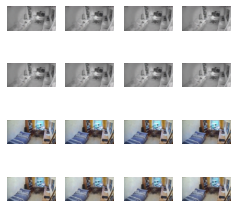

In [26]:
train(EPOCHS)

### Output training losses

In [27]:
epochs_arr = np.arange(EPOCHS)
gen_loss_arr = np.asarray(gen_train_loss)
disc_loss_arr = np.asarray(disc_train_loss)

training_loss = base_output_path + "img/training_loss.png"

plt.plot(epochs_arr, gen_loss_arr, "b", label="gen loss")
plt.plot(epochs_arr, disc_loss_arr, "y", label="disc loss")
plt.xlabel("epochs")
plt.xlabel("loss")
plt.legend(loc="upper right")

plt.savefig(training_loss)
plt.show()

Generator training loss per epoch: 	[<tf.Tensor: shape=(), dtype=float32, numpy=3.3836339>, <tf.Tensor: shape=(), dtype=float32, numpy=3.4254005>, <tf.Tensor: shape=(), dtype=float32, numpy=3.5313299>, <tf.Tensor: shape=(), dtype=float32, numpy=4.0819254>, <tf.Tensor: shape=(), dtype=float32, numpy=3.8874>, <tf.Tensor: shape=(), dtype=float32, numpy=4.527607>, <tf.Tensor: shape=(), dtype=float32, numpy=3.9345586>, <tf.Tensor: shape=(), dtype=float32, numpy=3.5883212>, <tf.Tensor: shape=(), dtype=float32, numpy=4.024099>, <tf.Tensor: shape=(), dtype=float32, numpy=3.7526865>]
Discriminator train loss per epoch: 	[<tf.Tensor: shape=(), dtype=float32, numpy=0.84955925>, <tf.Tensor: shape=(), dtype=float32, numpy=0.5922761>, <tf.Tensor: shape=(), dtype=float32, numpy=0.50327396>, <tf.Tensor: shape=(), dtype=float32, numpy=0.4369167>, <tf.Tensor: shape=(), dtype=float32, numpy=0.41347358>, <tf.Tensor: shape=(), dtype=float32, numpy=0.33029196>, <tf.Tensor: shape=(), dtype=float32, numpy=0.4

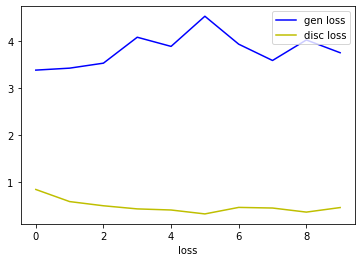

In [28]:
print("Generator training loss per epoch:",
      "\t" + str(gen_loss_arr))
print("Discriminator train loss per epoch:",
      "\t" + str(disc_loss_arr))

## Display any of the generated videos


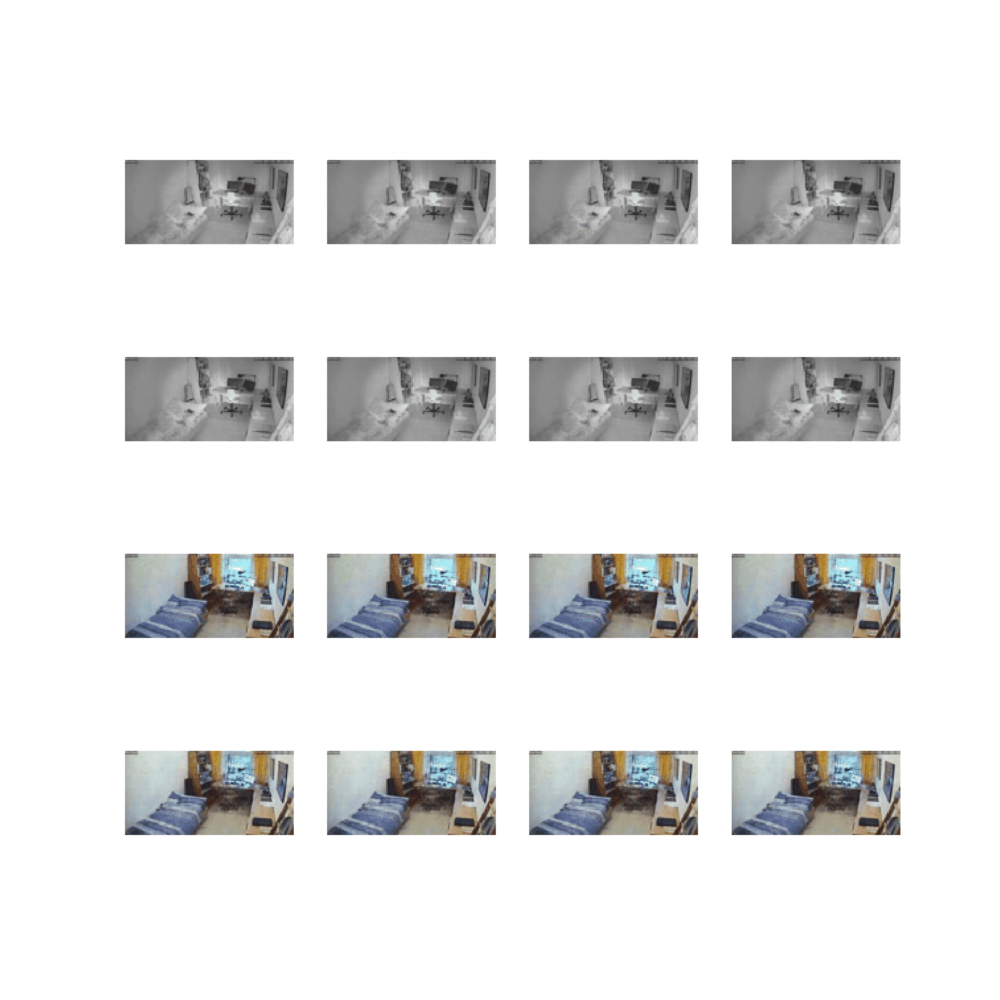

In [29]:
epoch_no = EPOCHS

embed.embed_file(anim_file_dir + "anim_at_epoch_{:04d}.gif".format(epoch_no))